# Анализ рынка заведений общественного питания Москвы

***Описание проекта:***

Инвесторы из фонда «Shut Up and Take My Money» планируют открыть заведение общественного питания в Москве.

***Цели исследования:***
- исследовать рынок заведений общественного питания Москвы
- найти интересные особенности и закономерности
- дать рекомендацию для открытия нового заведения

***Данные:***<br>
Структура moscow_places.csv:<br>
<code>name</code> — название заведения<br>
<code>address</code> — адрес заведения<br>
<code>category</code> — категория заведения<br>
<code>hours</code> — информация о днях и часах работы<br>
<code>lat</code> — широта географической точки, в которой находится заведение<br>
<code>lng</code> — долгота географической точки, в которой находится заведение<br>
<code>rating</code> — рейтинг заведения по оценкам пользователей в Яндекс Картах<br>
<code>price</code> — категория цен в заведении<br>
<code>avg_bill</code> — строка, которая хранит среднюю стоимость заказа в виде диапазона<br>
<code>middle_avg_bill</code> — число с оценкой среднего чека<br>
<code>middle_coffee_cup</code> — число с оценкой одной чашки капучино<br>
<code>chain</code> — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым<br>
<code>district</code> — административный район, в котором находится заведение<br>
<code>seats</code> — количество посадочных мест<br>

Презентация: https://disk.yandex.ru/i/zHPtgzdG5YnhAw

## Загрузка данных и изучение общей информации

### Импортирование библиотек

In [1]:
import pandas as pd
import seaborn as sns
from numpy import median
import matplotlib.pyplot as plt
from plotly import graph_objects as go 
import plotly.express as px
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
plt.rcParams["figure.figsize"] = (15,5)
pd.options.display.max_colwidth = 150

### Чтение файла

In [2]:
data = pd.read_csv('/datasets/moscow_places.csv')
data.sample(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5551,Новая,кафе,"Москва, Авиамоторная улица, 49/1с2",Юго-Восточный административный округ,"ежедневно, 09:00–23:00",55.750304,37.721286,4.9,NaN,NaN,NaN,NaN,0,NaN
7518,1001 Ночь,кафе,"Москва, Белореченская улица, 14",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.670015,37.763975,3.2,NaN,NaN,NaN,NaN,0,NaN
1555,Cofix,кофейня,"Москва, Щукинская улица, 42",Северо-Западный административный округ,"ежедневно, 10:00–22:00",55.809742,37.463778,3.9,NaN,Цена чашки капучино:60–120 ₽,NaN,90.0,1,150.0
8220,Шеф Гирос,быстрое питание,"Москва, проспект Андропова, 22",Южный административный округ,"ежедневно, 09:00–22:00",55.682823,37.661115,4.2,NaN,Средний счёт:250–350 ₽,300.0,NaN,0,300.0
1350,Avoday coffee and tea,кофейня,"Москва, Большая Академическая улица, 6, корп. 1",Северный административный округ,"пн-пт 07:00–21:00; сб,вс 08:00–21:00",55.818047,37.523301,4.7,средние,Цена чашки капучино:120–150 ₽,NaN,135.0,0,220.0


### Обзор данных

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


### Вывод

В исходных данных:
- 8406 строк
- 13 столбцов
- все столбцы в корректном формате
- есть пропуски, например в 11  middle_coffee_cup всего 535 заполенных строк из 8406.
- наименование столбцов в едином регистре

## Предобработка данных

### Проврека на пропуски

In [4]:
na_data = data.isna().sum().reset_index()
na_data.columns = ['name', 'na_sum']
na_data['na_%'] = round(na_data['na_sum'] / len(data) * 100, 2)
na_data.sort_values(by = 'na_sum', ascending = False)

,name,na_sum,na_%
11,middle_coffee_cup,7871,93.64
10,middle_avg_bill,5257,62.54
8,price,5091,60.56
9,avg_bill,4590,54.60
13,seats,3611,42.96
4,hours,536,6.38
0,name,0,0.00
1,category,0,0.00
2,address,0,0.00
3,district,0,0.00


<div style="border: 1px solid black; padding: 10px">
В исходных данных во всех категориях, где есть пропуски, процент недостоющей информации больше 5%. В одной из категорий, только 6% заполненных данных. Удаление пропусков может сказаться на ход анализа. Поэтому не целесообразно чистить данные от такого количества пустых строк.
</div>

### Проверка на дубликаты

In [5]:
data.duplicated().sum()

0

<div style="border: 1px solid black; padding: 10px">
явных дубликатов нет
</div>

In [6]:
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

<div style="border: 1px solid black; padding: 10px">
в столбце 'category' неявных дубликатов нет
</div>

In [7]:
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

<div style="border: 1px solid black; padding: 10px">
в столбце 'district' неявных дубликатов нет
</div>

In [8]:
data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

<div style="border: 1px solid black; padding: 10px">
в столбце 'price' неявных дубликатов нет
</div>

In [9]:
print('До перевода к нижнему регистру было', len(data['address'].unique()), 'уникальных адресов')
data['address'] = data['address'].str.lower()
print('После перевода к нижнему регистру стало', len(data['address'].unique()), 'уникальных адресов')

До перевода к нижнему регистру было 5753 уникальных адресов
После перевода к нижнему регистру стало 5752 уникальных адресов


<div style="border: 1px solid black; padding: 10px">
В столбце с адресом был обнаружен и удален 1 неявный дубликат.
</div>

In [10]:
print('До перевода к нижнему регистру было', len(data['name'].unique()), 'уникальных названий заведений')
data['name'] = data['name'].str.lower()
print('После перевода к нижнему регистру стало', len(data['name'].unique()), 'уникальных названий заведений')

До перевода к нижнему регистру было 5614 уникальных названий заведений
После перевода к нижнему регистру стало 5512 уникальных названий заведений


<div style="border: 1px solid black; padding: 10px">
В столбце с названием было обнаружено и удалено 102 неявных дубликата.
</div>

In [11]:
#Код ревьюера
data[['name', 'address']].duplicated().sum()

4

### Проверка на аномалии

In [12]:
print('Минимальное значение рейтинга', data['rating'].unique().min())
print('Максимальное значение рейтинга', data['rating'].unique().max())
print('Все уникальные значения рейтинга', data['rating'].unique())

Минимальное значение рейтинга 1.0
Максимальное значение рейтинга 5.0
Все уникальные значения рейтинга [5.  4.5 4.6 4.4 4.7 4.8 4.3 4.9 4.2 4.1 4.  3.8 3.9 3.7 3.6 2.8 2.7 3.1
 1.5 2.  1.4 3.3 3.5 3.2 2.9 3.  3.4 2.3 2.2 2.5 2.6 1.7 1.  1.1 2.4 1.3
 1.2 2.1 1.8 1.9 1.6]


<div style="border: 1px solid black; padding: 10px">
аномальных значений в рейтинге не обнаружено
</div>

In [13]:
data['chain'].unique()

array([0, 1])

<div style="border: 1px solid black; padding: 10px">
аномальных значений в столбце 'chain' не обнаружено
</div>

<AxesSubplot:>

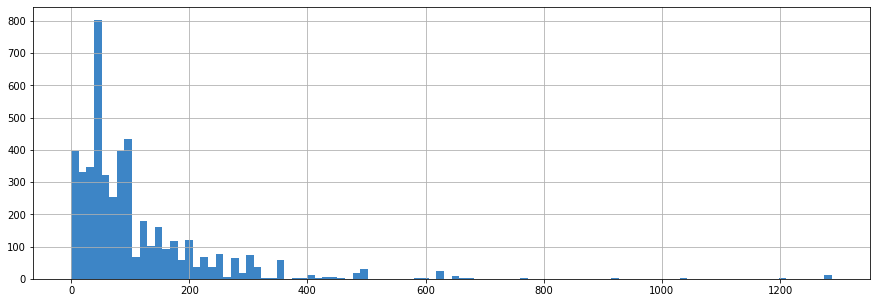

In [14]:
data['seats'].hist(bins = 100, color = '#3D85C6', figsize=(15,5))

<div style="border: 1px solid black; padding: 10px">
наблюдаются аномальные значения в столбце 'seats'. Интересно, что есть заведения, где больше 1200 посадочных мест. Скорее всего это не ошибка, а рестораны для проведения крупных мероприятий. Оставим эти значения, т.к. они могут понадобиться для будущего анализа.
</div>

### Проверка на корректность заполнения

In [15]:
dubl = data.query('chain == 0 and name.duplicated()')['name'].unique()
data.query('name in @dubl')['name'].value_counts()

кафе                    189
домино'с пицца           77
one price coffee         72
шаурма                   43
ресторан                 34
                       ... 
донер бистро              2
кофеin                    2
il pizzaiolo              2
ма ми                     2
ku: рамен изакая бар      2
Name: name, Length: 89, dtype: int64

<div style="border: 1px solid black; padding: 10px">
в данных есть несетевые заведения, названия которых встречаются более одного раза. Но названия не оригинальные, вряд ли это сети, оставим как есть.
</div>

In [16]:
no_chain = data.query('chain == 1')['name'].value_counts().reset_index()
no_chain.columns = ['name', 'count'] 
no_chain = no_chain.query('count == 1')
no_chain['name'].unique()

array(['ploveberry', 'дастархан', 'пивбар', 'уйгурский лагман',
       '4 сезона', 'хинкали', 'чай', 'сказка', 'кинобар', 'home',
       'zafferano', 'vintage', 'парк', 'bigсуши', 'лагман', 'диана',
       'чайхана-24', 'кофейник', 'поминальная трапеза',
       'хинкальная экспресс', 'крепери', 'миндаль', 'чайхана хан',
       'чао-пицца', 'шашлыки', 'пекарня № 1', 'сириус', 'мясо на углях',
       'виолино', 'ricers', 'пицца экспресс', 'прованс', 'роллофф',
       'чабан чуду', 'мореморе', '1-я креветочная', 'wаурма', 'kimpab',
       'баку', 'городок', 'drive', 'рома', 'tasty thai', 'барбарис',
       'радуга', 'кофе пью', 'китчен', 'харчевниковъ', 'ливан хаус',
       'бюро пиццы', 'bakery', 'suшi', 'бакинский дворик', 'halal food',
       'любовь и сладости', 'суши wok', 'easy pizza', 'дайнинг холл',
       'суши таун', 'суши-пицца 312', 'в своей тарелке'], dtype=object)

<div style="border: 1px solid black; padding: 10px">
есть сетевые заведения, названия которых встречаются один раз Поменяем их на несетевые.
</div>

In [17]:
data.loc[data['name'].isin(no_chain.name), 'chain'] = 0

### Добавление столбцов

In [18]:
data['street'] = data['address'].str.split(', ').str[1]

<div style="border: 1px solid black; padding: 10px">
создали отдельный столбец с названием улицы
</div>

In [19]:
#Код ревьюера
data.query('street == "проспект мира"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
718,все лень,ресторан,"москва, проспект мира, 119, стр. 528",Северо-Восточный административный округ,"пн-чт 12:00–21:00; пт,сб 12:00–22:00; вс 12:00–21:00",55.836107,37.614875,4.4,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,0,NaN,проспект мира
786,старое место,кафе,"москва, проспект мира, 119, стр. 504",Северо-Восточный административный округ,"ежедневно, 11:00–22:00",55.837212,37.616469,4.1,средние,Средний счёт:900–1100 ₽,1000.0,NaN,0,NaN,проспект мира
792,doner one,кафе,"москва, проспект мира, 119, стр. 596",Северо-Восточный административный округ,"ежедневно, 11:00–21:00",55.839037,37.613027,4.2,NaN,NaN,NaN,NaN,0,NaN,проспект мира
800,пян-се,быстрое питание,"москва, проспект мира, 119, стр. 27",Северо-Восточный административный округ,"ежедневно, 10:00–20:00",55.834563,37.613549,4.4,NaN,NaN,NaN,NaN,1,NaN,проспект мира
909,космос,кафе,"москва, проспект мира, 119, стр. 34",Северо-Восточный административный округ,вт-вс 10:45–21:00,55.835060,37.622033,3.8,NaN,NaN,NaN,NaN,0,NaN,проспект мира
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2568,ice embassy,кафе,"москва, проспект мира, 26, стр. 2",Центральный административный округ,"ежедневно, круглосуточно",55.777311,37.636400,4.4,NaN,NaN,NaN,NaN,0,273.0,проспект мира
2571,"халва, сеть почтоматов",кафе,"москва, проспект мира, 146",Северо-Восточный административный округ,пн-пт 10:00–19:00,55.820575,37.641970,3.6,NaN,NaN,NaN,NaN,0,18.0,проспект мира
2572,ресторан,ресторан,"москва, проспект мира, 62, стр. 1",Центральный административный округ,NaN,55.785618,37.635511,4.3,NaN,NaN,NaN,NaN,0,200.0,проспект мира
4782,food embassy,ресторан,"москва, проспект мира, 26, стр. 2",Центральный административный округ,"ежедневно, 10:00–00:00",55.777224,37.636288,4.5,высокие,Средний счёт:2500–3000 ₽,2750.0,NaN,0,273.0,проспект мира


In [20]:
data['is_24_7'] = data['hours'].str.contains('ежедневно, круглосуточно')
data['is_24_7'] = data['is_24_7'].fillna(False)

<div style="border: 1px solid black; padding: 10px">
создали отдельный столбце с обозначением, что заведение работает ежедневно и круглосуточно (24/7)
</div>

### Вывод

<div style="border: 1px solid black; padding: 10px">
- Было обнаружено до 90% пропущенных значений, удаление или замена которых значительно повлияет на будущий анализ. Было решено пропуски не трогать.<br>
- Явные дубликаты не были обнаружены.<br>
- Было обнаружено и удалено 103 неявных дубликата.<br>
- Есть большие аномалии в значениях 'seats', которые также было решено не трогать.<br>
- Сетевые заведения, названия которых встречаются только один раз были исправлены на 'несетевые'<br>
- Несетевые заведения, названия которых встречалось больше 1 раза были нетронуты, т.к. названия не уникальны<br>
- Были добавлены столбцы street и is_24_7
</div>

## Анализ данных

###  Функции для графиков

In [21]:
def heatmap (table, title, xlabel, ylabel, fmt='.2f'):
    sns.heatmap(table, cmap='BrBG', annot=True, fmt=fmt)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

In [22]:
def barh (table, title, xlabel, ylabel):
    plt.figure(figsize=(14,9))
    plt.barh(table.index, table['count'], color = '#004953')
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.yticks(rotation=45)
    plt.show()

In [23]:
def pie (table, title):
    fig = go.Figure(data=[go.Pie(labels=table.index, values=table)])
    fig.update_layout(title=title, title_x = 0.5)
    fig.update_layout(colorway=['#004953', '#efdecd','#8b4513', '#008ca0', '#87a96b', '#848482'])
    fig.show()

In [24]:
def maps (table, column, title):
    state_geo = '/datasets/admin_level_geomap.geojson'
    moscow_lat, moscow_lng = 55.751244, 37.618423
    
    m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
    
    Choropleth(geo_data=state_geo, data=table, columns=['district', column],key_on='feature.name', 
               fill_color='YlGn',fill_opacity=0.8, legend_name=title,).add_to(m)
    
    marker_cluster = MarkerCluster().add_to(m)
    def create_clusters(row):
        Marker(
            [row['lat'], row['lng']],
            popup=f"{row['name']} {row['rating']}",
        ).add_to(marker_cluster)
    
    data.apply(create_clusters, axis=1)
    
    return m

In [25]:
def hist(column, bins, title, ylabel, xlabel):
    plt.figure(figsize=(15,7))
    sns.histplot(data.query('category == "кофейня"')[column], bins=bins, color = '#004953')
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.show()

In [26]:
def boxplot(y, x, data, title, xlim1, xlim2, ylabel, xlabel):
    plt.figure(figsize=(15,10))
    sns.boxplot(y=y, x=x, data=data, showfliers=False, palette = 'BrBG')
    plt.title(title)
    plt.xlim(xlim1,xlim2)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.show()

### Количество объектов общественного питания по категориям

In [27]:
print('В Москве расположено', len(data), 'объектов общественного питания')

В Москве расположено 8406 объектов общественного питания


In [28]:
category_count = data.groupby('category')['name'].count().sort_values(ascending = False)
pie(category_count, 'Количество заведений по категориям')

<div style="border: 1px solid black; padding: 10px">
В данных 7 категорий заведений общественного питания: кафе, ресторан, кофейня, бар,паб, пиццерия, быстрое питание, столовая, булочная. <br>
28.3%(большую часть) заниимают кафе, чуть меньше (24.3%) занимают рестораны, меньше всего булочных (3.05%)
</div>

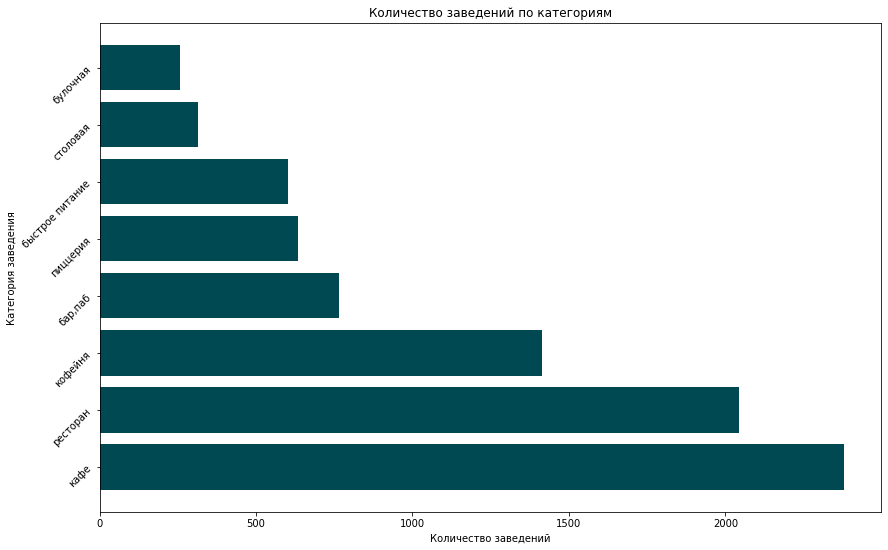

In [29]:
category_count = pd.DataFrame(data.groupby('category')['name'].count().sort_values(ascending = False))
category_count.columns = ['count']
barh (category_count, 'Количество заведений по категориям', 'Количество заведений', 'Категория заведения')

<div style="border: 1px solid black; padding: 10px">
На графике видно, что у кафе и ресторанов больше 2000 заведений. У остальных категорий заведений меньше 1500. 
</div>

### Количество посадочных мест в местах по категориям

In [30]:
print('В среднем в заведениях', data['seats'].median(), 'посадочных мест, если не учитывать категории заведений')

В среднем в заведениях 75.0 посадочных мест, если не учитывать категории заведений


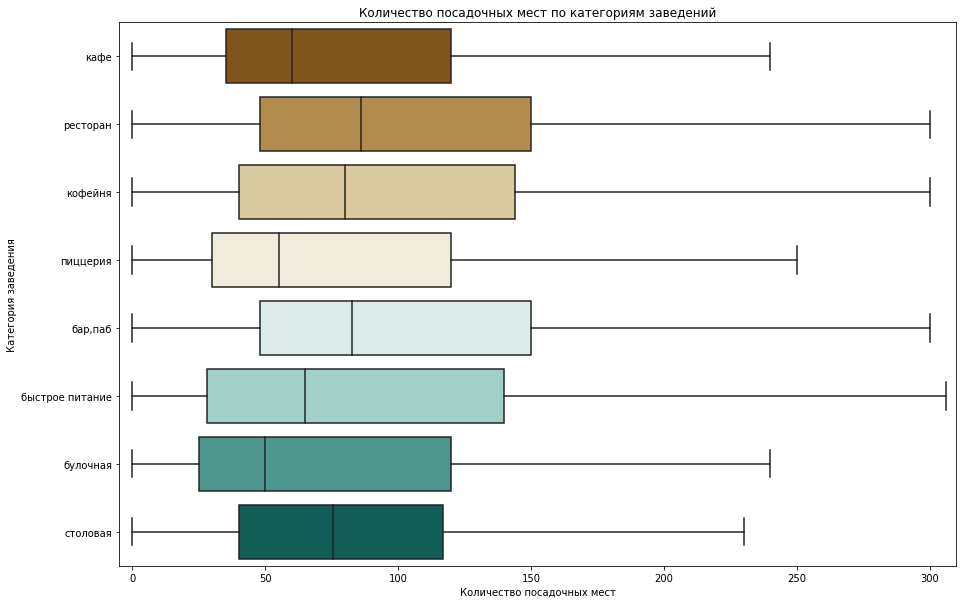

In [31]:
boxplot('category', 'seats', data, 
        'Количество посадочных мест по категориям заведений', -5, 310, 
        'Категория заведения', 'Количество посадочных мест')

<div style="border: 1px solid black; padding: 10px">
В среднем(медиана) рестораны(86) предоставляют больше посадочных мест, чем другие заведения. Бары и пабы(82) на втором месте. В то же время, пиццерии и булочные предлагают наименьшее количество мест для посадки(55 и 50 соответсвенно). Что интересно, у быстрого питания наибольший разброс по посадочным местам. Наименьший разброс у столовых
</div>

### Соотношение сетевых и несетевых заведений

In [32]:
data['chain'] = data['chain'].replace({0 : 'Несетевые', 1 : 'Сетевые'})
chain_count = data.groupby('chain')['name'].count()
pie(chain_count, 'Соотношение сетевых и несетевых заведений')

<div style="border: 1px solid black; padding: 10px">
Только треть(37.4%) заведений являются сетевыми. Остальные заведения не принадлежат к какой-либо сети
</div>

### Количество сетевых заведений по категориям

In [33]:
#chain = data.groupby(['category', 'chain'])['name'].count().reset_index()
#chain.columns = ['category', 'chain', 'count']
#chain

In [34]:
#plt.figure(figsize=(20, 10))
#sns.countplot(x='category', hue='chain', data=data, palette = 'BrBG')
#plt.xticks(rotation=0)
#plt.title('Соотношение сетевых заведений')
#plt.ylabel('Количество заведений')
#plt.xlabel('Категория')
#plt.show()

In [35]:
#Код ревьюера
df_chain_share = data.pivot_table(index='category', columns='chain', values='name', aggfunc='count')
df_chain_share.columns = ['not_chain', 'chain']
df_chain_share['total'] = df_chain_share['not_chain'] + df_chain_share['chain']
df_chain_share['share'] = (df_chain_share['chain']/df_chain_share['total']*100).round().astype('int')
df_chain_share.sort_values(by='share', ascending=False)
df_chain_share

,not_chain,chain,total,share
category,,,,
"бар,паб",601,164,765,21
булочная,100,156,256,61
быстрое питание,374,229,603,38
кафе,1629,749,2378,31
кофейня,698,715,1413,51
пиццерия,308,325,633,51
ресторан,1322,721,2043,35
столовая,230,85,315,27


In [36]:
import plotly.graph_objects as go
x = df_chain_share.index
fig = go.Figure()
fig.add_bar(x=x, y=df_chain_share['share'], name='Сетевые', marker_color='#004953', text=df_chain_share['chain'])
fig.add_bar(x=x, y=(100-df_chain_share['share']), name='Несетевые', marker_color='#efdecd', text=df_chain_share['not_chain'])
fig.update_layout(barmode="relative")
fig.update_layout(template='plotly_white')
fig.show()

<div style="border: 1px solid black; padding: 10px">
Кофейни, пиццерии и булочные чаще бывают сетевыми, чем несетевыми. Остальные категории чаще открываются только в одной точке.
</div>

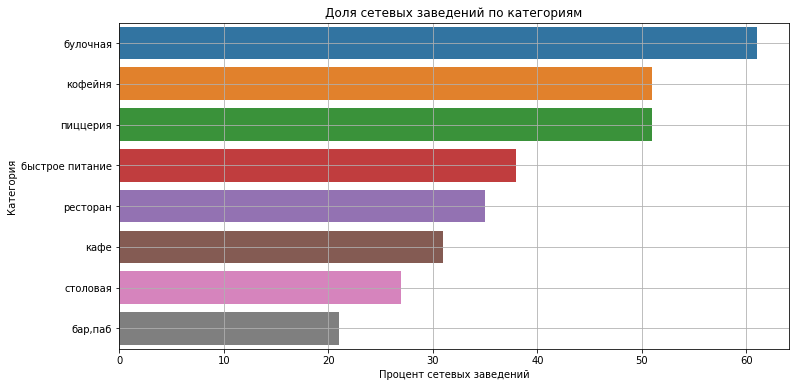

In [37]:
#Код ревьюера
plt.figure(figsize=(12, 6))
ax = sns.barplot(x='share', y='category', data=df_chain_share.reset_index().sort_values(by='share', ascending=False))
ax.set_xlabel('Процент сетевых заведений')
ax.set_ylabel('Категория')
ax.set_title('Доля сетевых заведений по категориям')

plt.grid()
plt.show()

### Топ-15 популярных сетей в Москве

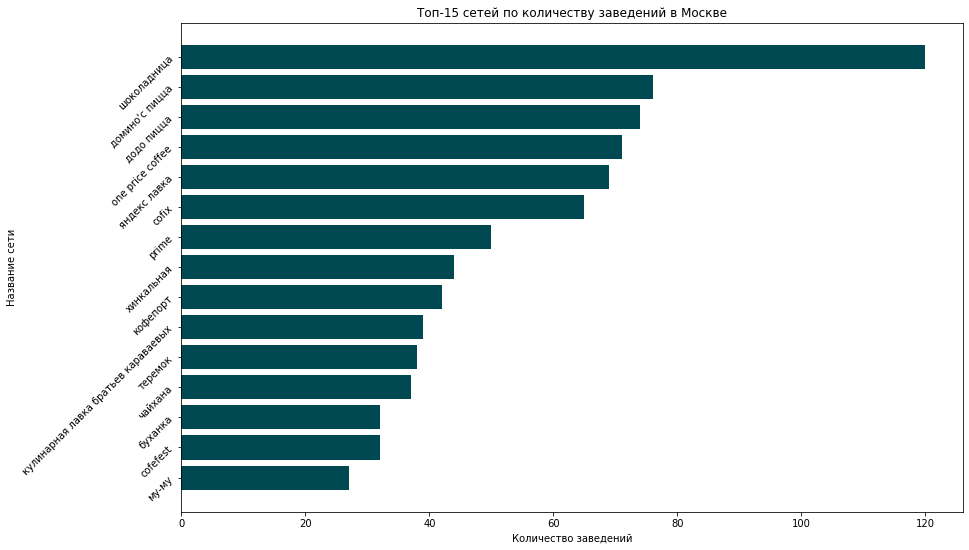

In [38]:
top_chains = pd.DataFrame(data.query('chain=="Сетевые"')
                          .groupby('name')['name']
                          .count()
                          .sort_values(ascending=False)
                          .head(15)
                          .sort_values(ascending=True))
top_chains.columns=['count']
barh(top_chains, 'Топ-15 сетей по количеству заведений в Москве', 'Количество заведений', 'Название сети')

In [39]:
top_chains_cat = data.query('name in @top_chains.index').groupby('name')['category'].unique()
top_chains_cat

name
cofefest                                                                                       [кофейня, кафе]
cofix                                                                                                [кофейня]
one price coffee                                                                                     [кофейня]
prime                                                                                         [ресторан, кафе]
буханка                                                                              [булочная, кофейня, кафе]
додо пицца                                                                                          [пиццерия]
домино'с пицца                                                                                      [пиццерия]
кофепорт                                                                                             [кофейня]
кулинарная лавка братьев караваевых                                                                     [ка

<div style="border: 1px solid black; padding: 10px">
Самым сетевым заведением является кофейня/кафе Шоколадница. У данного заведения 120 точек в Москве.<br>
На втором и третьем месте пиццерии Домино'с и Додо Пицца. Что интересно, т.к. пиццерии не входилии в топ-3 категории.
</div>

### Количество заведений каждой категории по районам

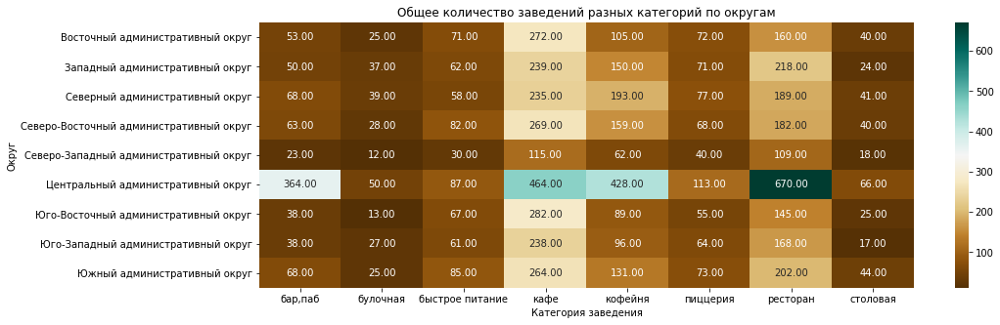

In [40]:
district_count = data.pivot_table(index='district',
                                   columns='category',
                                   values='name',
                                   aggfunc='count')

heatmap(district_count,
             'Общее количество заведений разных категорий по округам',
             'Категория заведения',
             'Округ')

<div style="border: 1px solid black; padding: 10px">
Больше всего заведений в категориях ресторанов, кафе и кофеен, а территориально они наиболее многочисленны в центральном округе.
Интересно, что центральный округ отмечен большим количествм баров, по количеству сравимо с кафе и кофейнями, а в остальных округах - это одна из самых малочисленных категорий заведений.
</div>

### Распределение средних рейтингов по категориям заведений

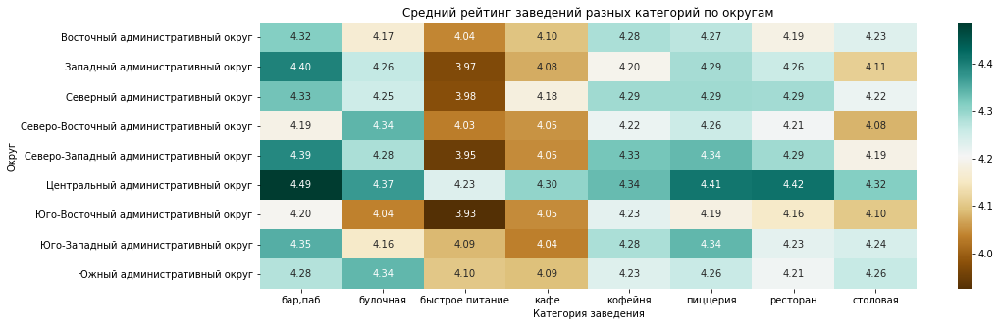

In [41]:
rating_count = data.pivot_table(index='district',
                                   columns='category',
                                   values='rating',
                                   aggfunc='mean')

heatmap(rating_count,
             'Cредний рейтинг заведений разных категорий по округам',
             'Категория заведения',
             'Округ')

<div style="border: 1px solid black; padding: 10px">
Бары и пабы имеют наивысший рейтинг, тогда как пиццерии, рестораны, кофейни и булочные имеют примерно одинаковый рейтинг. Рестораны быстрого питания имеют наименьший рейтинг, кафе также редко удовлетворяет потребителей. Интересно, что в ЦАО рейтинги лучше, чем в других округах. Самые недовольные клиенты находятся в ЮВАО.
</div>

### Фоновая картограмма со средним рейтингом заведений каждого района

In [42]:
rating_district = data.groupby('district', as_index=False)['rating'].agg('mean')

maps(rating_district, 'rating', 'Средний рейтинг заведений по районам')


<div style="border: 1px solid black; padding: 10px">
Фоновая картгграмма подтведила предыдущие выводы, что у заведений, расположенных в Центральном административном округе, наивысший рейтинг, составляющий 4.38. В то же время заведения, расположенные в Юго-Восточном административном округе, имеют наименьший рейтинг, который составляет 4.1.
</div>

### Топ-15 улиц по количеству заведений

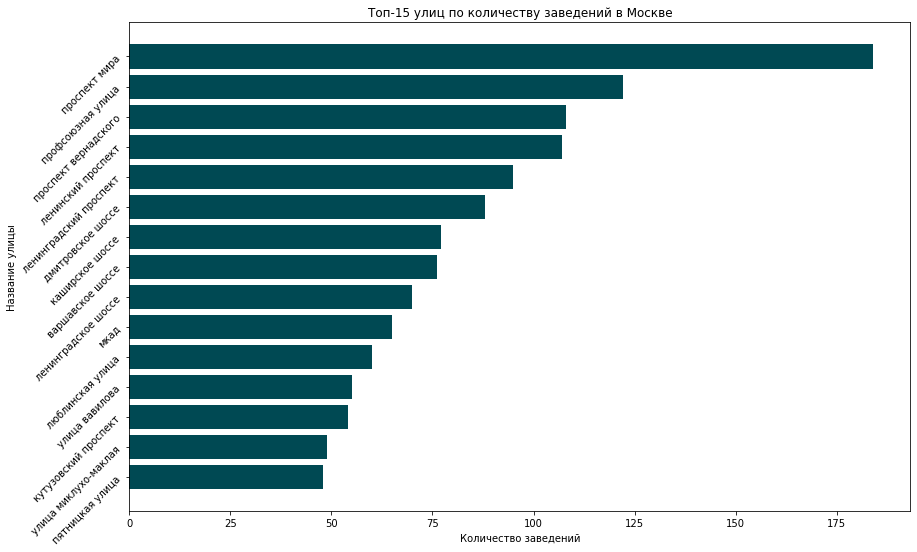

In [43]:
top_streets = pd.DataFrame(data.groupby('street')['name']
                          .count()
                          .sort_values(ascending=False)
                          .head(15)
                          .sort_values(ascending=True))
top_streets.columns=['count']

barh(top_streets, 'Топ-15 улиц по количеству заведений в Москве', 'Количество заведений', 'Название улицы')

<div style="border: 1px solid black; padding: 10px">
Самой популярной улицей для заведений является Проспект мира(184 заведения), на втором месте - Профсоюзная улица(122)
</div>

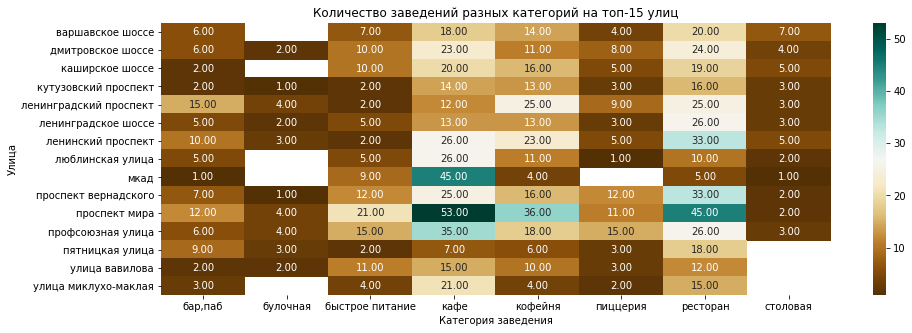

In [44]:
street_count = data.query('street in @top_streets.index').pivot_table(index='street',
                                   columns='category',
                                   values='name',
                                   aggfunc='count')

heatmap(street_count,
             'Количество заведений разных категорий на топ-15 улиц',
             'Категория заведения',
             'Улица')

<div style="border: 1px solid black; padding: 10px">
На топ-15 улиц больше всего расположено кафе, ресторанов и кофеен, меньше всего булочных, пиццерий и столовых.<br>
К сожалению, данный анализ не полностью информативен, т.к. в топ попали очень длинные улицы, например МКАД, общее количество заведений на них ничего не говорит о плотности улице или ее популярности. 
</div>

### Улицы, на которых находится только один объект общепита

In [45]:
one_place = data['street'].value_counts().reset_index()
one_place = one_place.query('street == 1')
one_place.columns = ['street_name', 'count']
print('Количество улиц, на которых находится только один объект общепита:' , len(one_place))

Количество улиц, на которых находится только один объект общепита: 457


In [46]:
one_place_count = data.query('street in @one_place.street_name')
one_place_count = one_place_count.groupby('category')['street'].count().sort_values(ascending = False)
one_place_count

category
кафе               159
ресторан            93
кофейня             84
бар,паб             39
столовая            36
быстрое питание     23
пиццерия            15
булочная             8
Name: street, dtype: int64

<div style="border: 1px solid black; padding: 10px">
Кафе чаще всех находятся единсвенными объектами общепита на улице. Реже всех - булочные.
</div>

### Анализ цен в центральном административном округе и других

In [47]:
avg_bill_district = data.groupby('district', as_index=False)['middle_avg_bill'].agg('median')

maps(avg_bill_district, 'middle_avg_bill', 'Цены по районам')

<div style="border: 1px solid black; padding: 10px">
Средний чек в центре и в западном округе самый дорогой, около 1000руб. Самые дешевые -  южный, юго-восточный и северо-восточный округа, здесь чек может быть в два раза ниже. В остальных округах средний чек колеблется в районе 700 руб.
</div>

In [48]:
avg_bill_district.sort_values(by = 'middle_avg_bill', ascending = 'False')

,district,middle_avg_bill
6,Юго-Восточный административный округ,450.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
0,Восточный административный округ,575.0
7,Юго-Западный административный округ,600.0
2,Северный административный округ,650.0
4,Северо-Западный административный округ,700.0
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0


### Вывод

<div style="border: 1px solid black; padding: 10px">
В Москве расположено 8406 объектов общественного питания<br>
Больше всего заведений в категориях ресторанов, кафе и кофеен, а территориально они наиболее многочисленны в центральном округе.<br>
В среднем рестораны предоставляют больше посадочных мест, чем другие заведения. <br>
Только треть заведений являются сетевыми. Остальные заведения не принадлежат к какой-либо сети<br>
Чаще всего сетевыми делат кафе, рестораны и кофейни. У них приблизительно одинаковые доли(23,8, 23 и 22,7% соответсвенно).<br>
Самым сетевым заведением является кофейня/кафе Шоколадница. У данного заведения 120 точек в Москве.<br>
Бары и пабы имеют наивысший рейтинг, тогда как пиццерии, рестораны, кофейни и булочные имеют примерно одинаковый рейтинг.<br>
В ЦАО рейтинги лучше, чем в других округах. Самые недовольные клиенты находятся в ЮВАО.<br>
Самой популярной улицей для заведений является Проспект мира(184 заведения), на втором месте - Профсоюзная улица(122)<br>
На топ-15 улиц больше всего расположено кафе, ресторанов и кофеен, меньше всего булочных, пиццерий и столовых.<br>
Кафе чаще всех находятся единсвенными объектами общепита на улице. Реже всех - булочные.<br>
Средний чек в центре и в западном округе самый дорогой, около 1000руб. Самые дешевые -  южный, юго-восточный и северо-восточный округа, здесь чек может быть в два раза ниже. В остальных округах средний чек колеблется в районе 700 руб.
</div>

## Детализируем исследование: открытие кофейни

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [49]:
print('Всего в Москве',len(data.query('category == "кофейня"')),'кофеен')

Всего в Москве 1413 кофеен


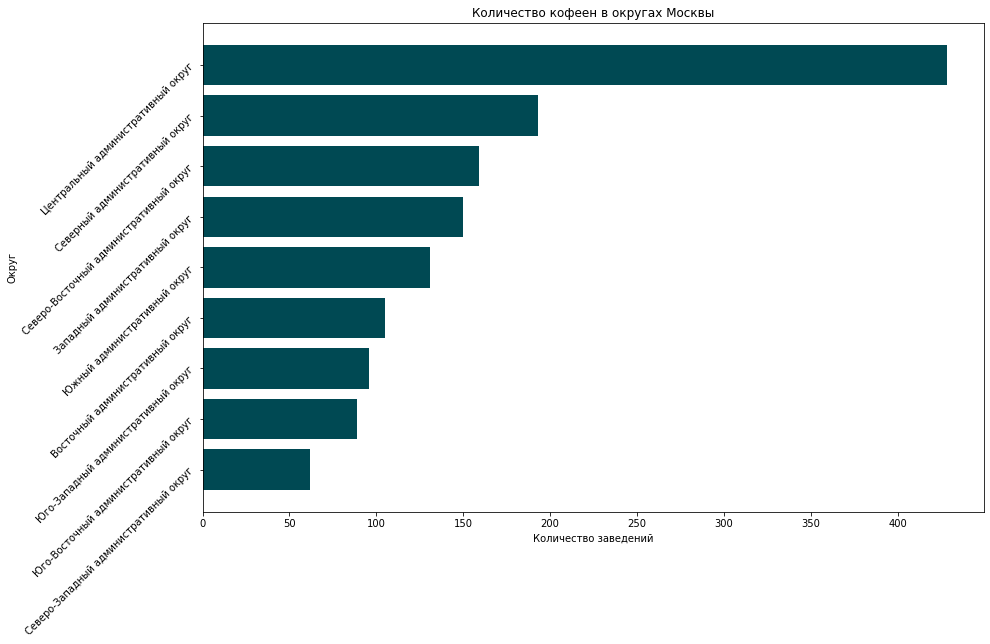

In [50]:
cafe = pd.DataFrame(data.query('category == "кофейня"').groupby('district')['name'].count().sort_values(ascending=True))
cafe.columns = ['count']
barh(cafe, 'Количество кофеен в округах Москвы', 'Количество заведений', 'Округ')

<div style="border: 1px solid black; padding: 10px">
Больше всего кофеен в центральном округе, более 400 кофеен, что в два раза больше чем в любом другом округе.<br>
Меньше всего - в Северо-Западном, Юго-Восточном и Юго-Западном, менее 100 кофеен.
</div>

### Есть ли круглосуточные кофейни?

In [51]:
print('Всего в Москве', len(data.query('category == "кофейня" and is_24_7 == True')), 'круглосуточных кофеен')

Всего в Москве 59 круглосуточных кофеен


In [52]:
cafe_24 = data.loc[data['category'] == "кофейня"]
cafe_24['is_24_7'] = cafe_24['is_24_7'].replace({False : 'Остальные', True : 'Круглосуточные'})
cafe_24 = cafe_24.groupby('is_24_7')['name'].count()
pie(cafe_24, 'Доля круглосуточных кофеен')

/tmp/ipykernel_78/2069465520.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<div style="border: 1px solid black; padding: 10px">
Круглосуточные кофейни - большая редкость. Только 5% кофеен работают без перерыва.
</div>

### Какие у кофеен рейтинги? Как они распределяются по районам?

In [53]:
print('В среднем у кофеен рейтинг равен', data.query('category == "кофейня"')['rating'].median())

В среднем у кофеен рейтинг равен 4.3


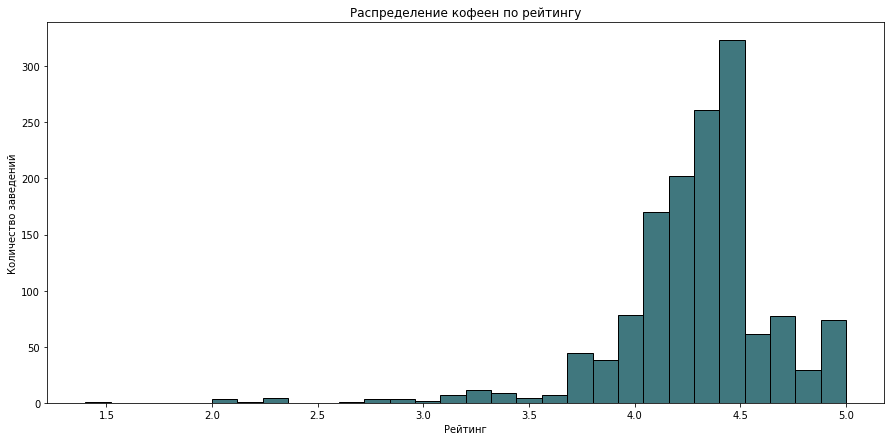

In [54]:
hist('rating', 30, 'Распределение кофеен по рейтингу'
     , 'Количество заведений', 'Рейтинг')

<div style="border: 1px solid black; padding: 10px">
Чаще всего кофейням ставят 4.1-4.6. Рейтинг ниже 3 - редкость.
</div>

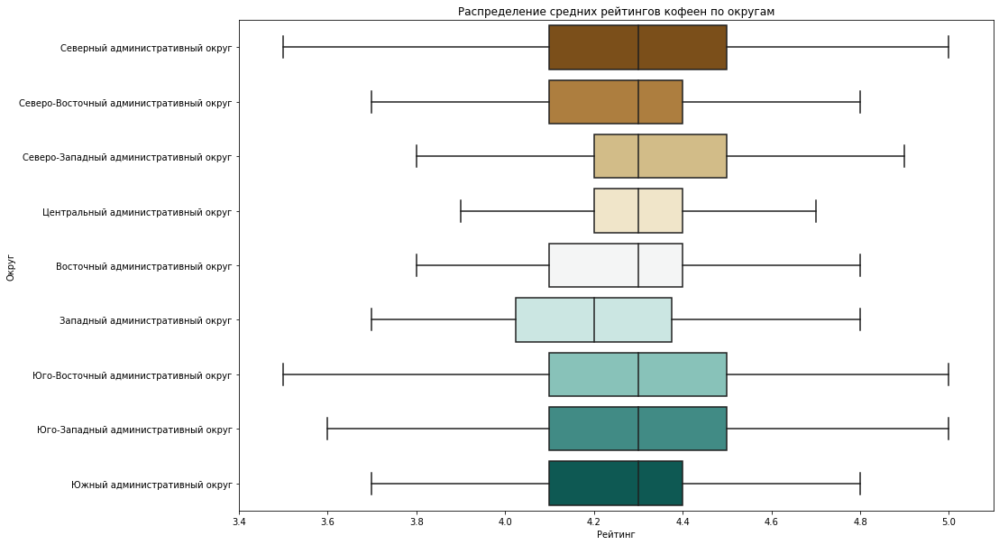

In [55]:
boxplot('district', 'rating', data.query('category == "кофейня"'), 'Распределение средних рейтингов кофеен по округам' , 3.4, 5.1, 
        'Округ', 'Рейтинг')

<div style="border: 1px solid black; padding: 10px">
Интересно, что медиана на одном уровне у всех районов, кроме ЗАО. Но шансы на высокую оценку выше в САО, СЗАО, ЮВАО и ЮЗАО, т.к. у них разброс в правую сторону выше. 
</div>

### На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [56]:
print('В среднем чашка капучино стоит', data.query('category == "кофейня"')['middle_coffee_cup'].median(), 'рублей')

В среднем чашка капучино стоит 170.0 рублей


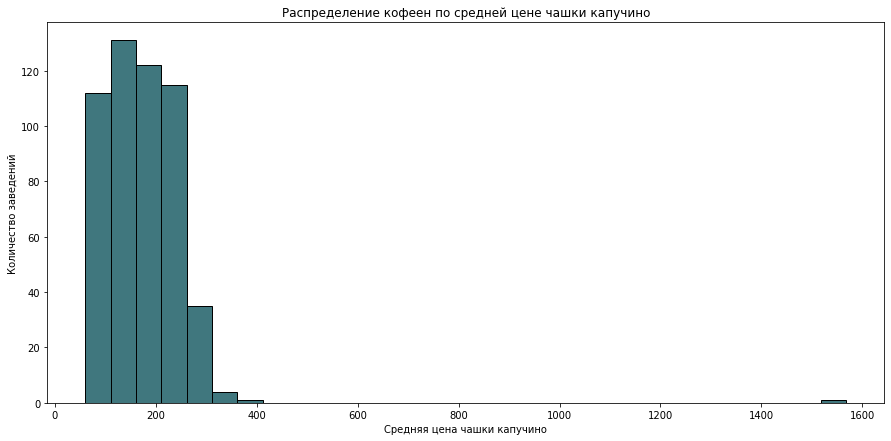

In [57]:
hist('middle_coffee_cup', 30, 'Распределение кофеен по средней цене чашки капучино'
     , 'Количество заведений', 'Средняя цена чашки капучино')

<div style="border: 1px solid black; padding: 10px">
Есть выбросы, чуть больше 1500 рублей за чашку, но это аномалия. Чаще всего купить чашку капучино в Моске можно за 100-150 рублей. Чуть реже за 150-250 рублей.
</div>

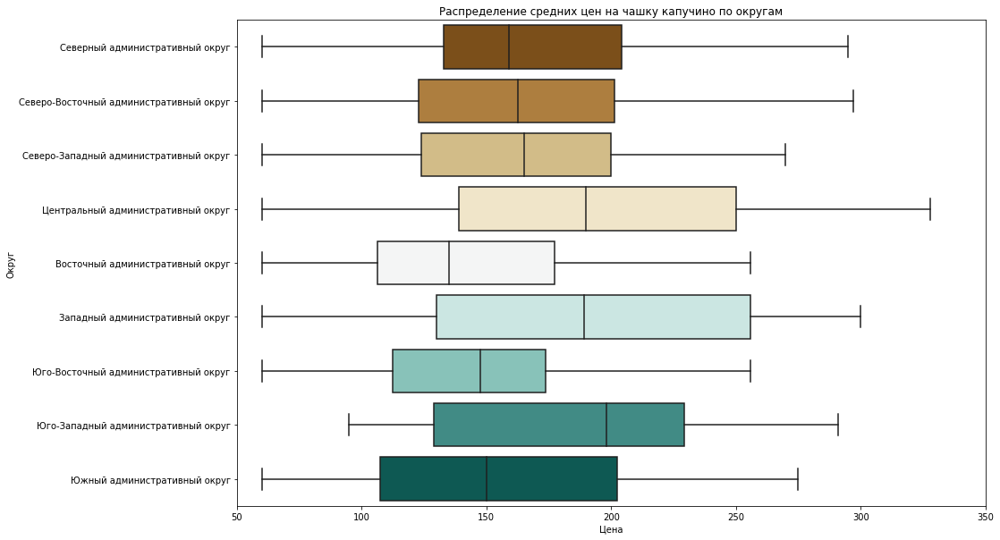

In [58]:
boxplot('district', 'middle_coffee_cup', data.query('category == "кофейня"'), 'Распределение средних цен на чашку капучино по округам' , 50, 350, 
        'Округ', 'Цена')

<div style="border: 1px solid black; padding: 10px">
Самый дорогой кофе в Юго-Западном районе, около 200 рублей. Самый дешевый в Восточном районе. Но цены отличаются, от округа к округу, поэтому местоположение очень важный фактор для ценообразования.
</div>

### Количество посадочных мест в кофейнях

In [59]:
print('В среднем в кофейнях', data.query('category == "кофейня"')['seats'].median(), 'мест')

В среднем в кофейнях 80.0 мест


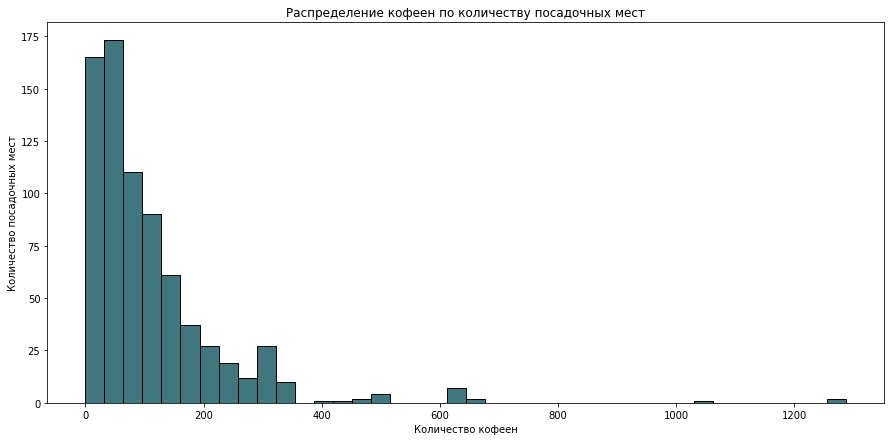

In [60]:
hist('seats', 40, 'Распределение кофеен по количеству посадочных мест'
     , 'Количество посадочных мест', 'Количество кофеен')

<div style="border: 1px solid black; padding: 10px">
Чаще всего в кофейнях от 0 до 100 посадочных мест, но также бывают исключения. Например кофейня, где больше 1200 мест.
</div>

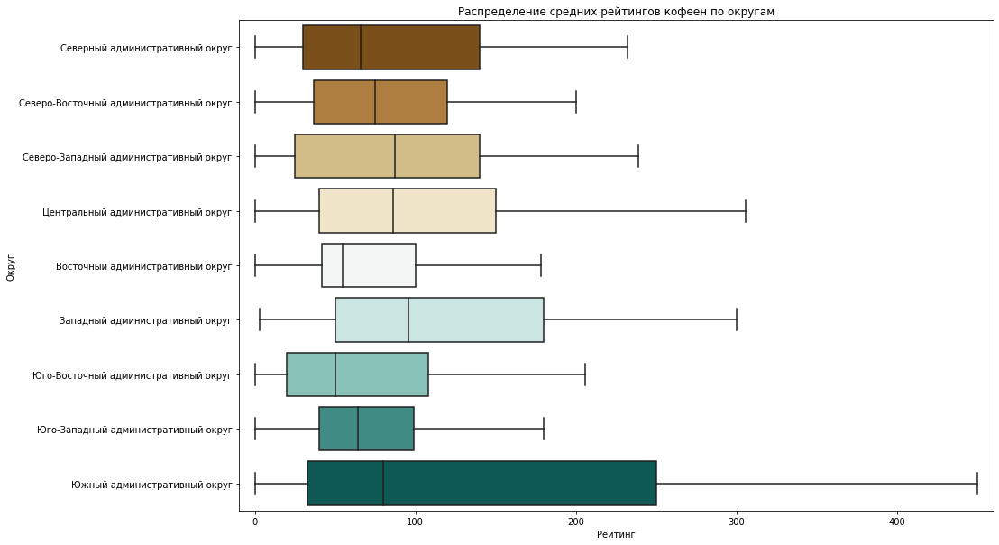

In [61]:
boxplot('district', 'seats', data.query('category == "кофейня"'), 'Распределение средних рейтингов кофеен по округам' , -10, 460, 
        'Округ', 'Рейтинг')

<div style="border: 1px solid black; padding: 10px">
Самые маленькие кофейни в ЮВАО, а самые большие в ЗАО. Хотя в ЮАО самый большой разброс. Здесь можно найти кофейню на большое количество посетителей.
</div>

### Вывод

<div style="border: 1px solid black; padding: 10px">
Всего в Москве 1413 кофеен<br>
Больше всего кофеен в центральном округе<br>
Меньше всего - в Северо-Западном, Юго-Восточном и Юго-Западном<br>
В Москве 59 круглосуточных кофеен - это всего 5%.<br>
Чаще всего кофейням ставят 4.1-4.6. Рейтинг ниже 3 - редкость.<br>
Чаще всего купить чашку капучино в Моске можно за 100-150 рублей. Чуть реже за 150-250 рублей.<br>
Самый дорогой кофе в Юго-Западном районе, около 200 рублей. Самый дешевый в Восточном районе.<br>
Чаще всего в кофейнях от 0 до 100 посадочных мест<br>
Самые маленькие кофейни в ЮВАО, а самые большие в ЗАО.<br>
</div>

## Общий вывод

В данном исследовании был проведен анализ рынка заведений общественного питания Москвы. Целью было найти интересные особенности и закономерности, а также дать рекомендацию для открытия нового заведения

На этапе предобработки данных:
- Было обнаружено до 90% пропущенных значений. Было решено пропуски не трогать.<br>
- Явные и неявные дубликаты не были обнаружены.<br>
- Были исправлены ошибки в значениях сетевых заведений
- Были добавлены столбцы street и is_24_7

На этапе анализа данных было выявлено, что:
- В Москве расположено 8406 объектов общественного питания
- Больше всего заведений в категориях ресторанов, кафе и кофеен, а территориально они наиболее многочисленны в центральном округе.
- Только треть заведений являются сетевыми.
- Чаще всего сетевыми делат кафе, рестораны и кофейни.
- Бары и пабы имеют наивысший рейтинг, тогда как пиццерии, рестораны, кофейни и булочные имеют примерно одинаковый рейтинг.
- В ЦАО рейтинги лучше, чем в других округах. Самые недовольные клиенты находятся в ЮВАО.
- Самой популярной улицей для заведений является Проспект мира(184 заведения).
- Кафе чаще всех находятся единсвенными объектами общепита на улице. 
- Средний чек в центре и в западном округе самый дорогой, около 1000руб.

На этапе детализации исследования было вяылено, что:
- Больше всего кофеен в центральном округе.
- Всего 5% кофеен круглосуточные.
- Чаще всего кофейням ставят 4.1-4.6.
- Чаще всего купить чашку капучино в Моске можно за 100-150 рублей. Чуть реже за 150-250 рублей.
- Самый дорогой кофе в Юго-Западном районе, около 200 рублей. Самый дешевый в Восточном районе.
- Чаще всего в кофейнях от 0 до 100 посадочных мест

Общие выводы:<br>
Открытые кофейни является хорошей идеет, т.к. это одна из самых популярных категорий, в будущем можно сделать сеть, рейтинги данным заведениям не занижают, а размер кофейни не играет большой роли - есть кофейни с 0 посадочных мест, а есть с 1200.


Рекомендации:<br>
При выборе места расположения кофейни стоит рассмотреть юго-западный округ по нескольким причинам:
- Высокая средняя цена за чашку капучинно
- Низкая конкуренция
- Платежеспособные жильца районов
- Жильцы склонны ставить хорошие оценки<br>


Цена на чашку каппучино должна быть в районе 150-250 рублей<br>
Количество посадочных мест должно быть 60-10.<br>
Стоит рассмотреть возможность круглосуточной работы, т.к. всего 5% кофеен в Москве работают круглосуточно. <br>


Презентация: https://disk.yandex.ru/i/zHPtgzdG5YnhAw